## Import TensorFlow and other libraries and mount google drive

In [ ]:
import tensorflow as tf

import os
import pathlib
import time
import datetime

from matplotlib import pyplot as plt
from IPython import display
tf.__version__

'2.9.2'

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


#Dataset creation

In [ ]:
!unzip /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Dataset/Training.zip > logs.txt

In [ ]:
bokeh_GT = "/content/bokeh/"
bokeh_Original = "/content/original/"

Each original image is of size `256 x 512` containing two `256 x 256` images:

In [ ]:
sample_image = tf.io.read_file(str(bokeh_Original + '1.jpg'))
sample_image = tf.io.decode_jpeg(sample_image)
print(sample_image.shape)

(1024, 1491, 3)


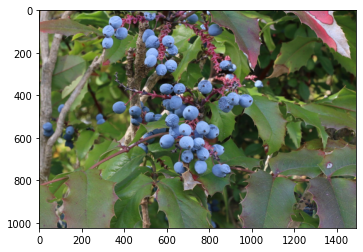

In [ ]:
plt.figure()
plt.imshow(sample_image)

In [ ]:
def load(image_file):
  # Read and decode an image file to a uint8 tensor
  if type(image_file) == str:
    base_image_name = os.path.basename(image_file)
  else:
    #print(type(image_file))
    parts = tf.strings.split(image_file, os.path.sep)
    #image_file = bytes.decode(image_file)
    #image_file = tf.numpy_function(image_file)
    #base_image_name = os.path.basename(image_file.decode("utf-8"))
    base_image_name = parts[-1]
    #print(base_image_name)
  
  #print(bokeh_Original + "/" + base_image_name)
  image = tf.io.read_file(bokeh_Original + "/" + base_image_name)
  input_image = tf.io.decode_jpeg(image)

  image = tf.io.read_file(bokeh_GT + "/" + base_image_name)
  bokeh_image = tf.io.decode_jpeg(image)

  # Convert both images to float32 tensors
  input_image = tf.cast(input_image, tf.float32)
  bokeh_image = tf.cast(bokeh_image, tf.float32)

  return input_image, bokeh_image

Plot a sample of the input (architecture label image) and real (building facade photo) images:

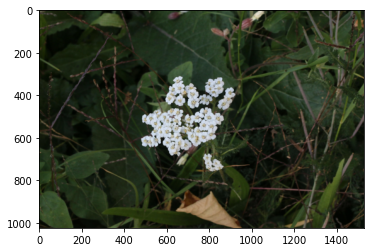

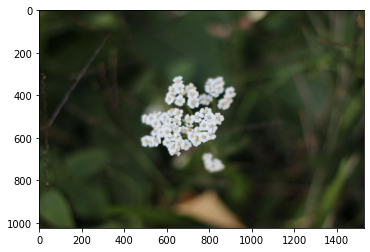

In [ ]:
inp, re = load('100.jpg')
# Casting to int for matplotlib to display the images
plt.figure()
plt.imshow(inp / 255.0)
plt.figure()
plt.imshow(re / 255.0)

In [ ]:
!ls -lh /content/bokeh/ | wc -l

4695


In [ ]:
# The facade training set consist of 400 images
BUFFER_SIZE = 1000
# The batch size of 1 produced better results for the U-Net in the original pix2pix experiment
BATCH_SIZE = 1
# Each image is 256x256 in size
IMG_WIDTH = 256
IMG_HEIGHT = 256

In [ ]:
def resize(input_image, real_image, height, width):
  input_image = tf.image.resize(input_image, [height, width],
                                method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  real_image = tf.image.resize(real_image, [height, width],
                               method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)

  return input_image, real_image

In [ ]:
# Normalizing the images to [-1, 1]
def normalize(input_image, real_image):
  input_image = (input_image / 127.5) - 1
  real_image = (real_image / 127.5) - 1

  return input_image, real_image

In [ ]:
def load_image_train(image_file):
  input_image, real_image = load(image_file)
  input_image, real_image = resize(input_image, real_image,
                                  IMG_HEIGHT, IMG_WIDTH)
  #input_image, real_image = random_jitter(input_image, real_image)
  input_image, real_image = normalize(input_image, real_image)

  return input_image, real_image

In [ ]:
def load_image_test(image_file):
  input_image, real_image = load(image_file)
  input_image, real_image = resize(input_image, real_image,
                                   IMG_HEIGHT, IMG_WIDTH)
  input_image, real_image = normalize(input_image, real_image)

  return input_image, real_image

In [ ]:
bokeh_GT = "/content/bokeh/"
bokeh_Original = "/content/original/"

In [ ]:
train_dataset = tf.data.Dataset.list_files(str(bokeh_Original + '*.jpg'))
train_dataset = train_dataset.map(load_image_train,
                                  num_parallel_calls=tf.data.AUTOTUNE)
train_dataset = train_dataset.shuffle(BUFFER_SIZE)
train_dataset = train_dataset.batch(BATCH_SIZE)

In [ ]:
try:
  test_dataset = tf.data.Dataset.list_files(str(PATH / 'test/*.jpg'))
except tf.errors.InvalidArgumentError:
  test_dataset = tf.data.Dataset.list_files(str(PATH / 'val/*.jpg'))
test_dataset = test_dataset.map(load_image_test)
test_dataset = test_dataset.batch(BATCH_SIZE)

# Build the generator

In [ ]:
OUTPUT_CHANNELS = 3

In [ ]:
def downsample(filters, size, apply_batchnorm=True):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
      tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer=initializer, use_bias=False))

  if apply_batchnorm:
    result.add(tf.keras.layers.BatchNormalization())

  result.add(tf.keras.layers.LeakyReLU())

  return result

In [ ]:
down_model = downsample(3, 4)
down_result = down_model(tf.expand_dims(inp, 0))
print (down_result.shape)

(1, 512, 764, 3)


In [ ]:
def upsample(filters, size, apply_dropout=False):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
    tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                    padding='same',
                                    kernel_initializer=initializer,
                                    use_bias=False))

  result.add(tf.keras.layers.BatchNormalization())

  if apply_dropout:
      result.add(tf.keras.layers.Dropout(0.5))

  result.add(tf.keras.layers.ReLU())

  return result

In [ ]:
up_model = upsample(3, 4)
up_result = up_model(down_result)
print (up_result.shape)

(1, 1024, 1528, 3)


In [ ]:
def Generator():
  inputs = tf.keras.layers.Input(shape=[256, 256, 3])

  down_stack = [
    downsample(64, 4, apply_batchnorm=False),  # (batch_size, 128, 128, 64)
    downsample(128, 4),  # (batch_size, 64, 64, 128)
    downsample(256, 4),  # (batch_size, 32, 32, 256)
    downsample(512, 4),  # (batch_size, 16, 16, 512)
    downsample(512, 4),  # (batch_size, 8, 8, 512)
    downsample(512, 4),  # (batch_size, 4, 4, 512)
    downsample(512, 4),  # (batch_size, 2, 2, 512)
    downsample(512, 4),  # (batch_size, 1, 1, 512)
  ]

  up_stack = [
    upsample(512, 4, apply_dropout=True),  # (batch_size, 2, 2, 1024)
    upsample(512, 4, apply_dropout=True),  # (batch_size, 4, 4, 1024)
    upsample(512, 4, apply_dropout=True),  # (batch_size, 8, 8, 1024)
    upsample(512, 4),  # (batch_size, 16, 16, 1024)
    upsample(256, 4),  # (batch_size, 32, 32, 512)
    upsample(128, 4),  # (batch_size, 64, 64, 256)
    upsample(64, 4),  # (batch_size, 128, 128, 128)
  ]

  initializer = tf.random_normal_initializer(0., 0.02)
  last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 4,
                                         strides=2,
                                         padding='same',
                                         kernel_initializer=initializer,
                                         activation='tanh')  # (batch_size, 256, 256, 3)

  x = inputs

  # Downsampling through the model
  skips = []
  for down in down_stack:
    x = down(x)
    skips.append(x)

  skips = reversed(skips[:-1])

  # Upsampling and establishing the skip connections
  for up, skip in zip(up_stack, skips):
    x = up(x)
    x = tf.keras.layers.Concatenate()([x, skip])

  x = last(x)

  return tf.keras.Model(inputs=inputs, outputs=x)

Visualize the generator model architecture:

In [ ]:
generator = Generator()
tf.keras.utils.plot_model(generator, show_shapes=True, dpi=64)

Test the generator:

In [ ]:
gen_output = generator(inp[tf.newaxis, ...], training=False)
plt.imshow(gen_output[0, ...])

### Generator loss

In [ ]:
LAMBDA = 100

In [ ]:
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [ ]:
def generator_loss(disc_generated_output, gen_output, target):
  gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

  # Mean absolute error
  l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

  total_gen_loss = gan_loss + (LAMBDA * l1_loss)

  return total_gen_loss, gan_loss, l1_loss

# Build the discriminator

In [ ]:
def Discriminator():
  initializer = tf.random_normal_initializer(0., 0.02)

  inp = tf.keras.layers.Input(shape=[256, 256, 3], name='input_image')
  tar = tf.keras.layers.Input(shape=[256, 256, 3], name='target_image')

  x = tf.keras.layers.concatenate([inp, tar])  # (batch_size, 256, 256, channels*2)

  down1 = downsample(64, 4, False)(x)  # (batch_size, 128, 128, 64)
  down2 = downsample(128, 4)(down1)  # (batch_size, 64, 64, 128)
  down3 = downsample(256, 4)(down2)  # (batch_size, 32, 32, 256)

  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3)  # (batch_size, 34, 34, 256)
  conv = tf.keras.layers.Conv2D(512, 4, strides=1,
                                kernel_initializer=initializer,
                                use_bias=False)(zero_pad1)  # (batch_size, 31, 31, 512)

  batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

  leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)  # (batch_size, 33, 33, 512)

  last = tf.keras.layers.Conv2D(1, 4, strides=1,
                                kernel_initializer=initializer)(zero_pad2)  # (batch_size, 30, 30, 1)

  return tf.keras.Model(inputs=[inp, tar], outputs=last)

Visualize the discriminator model architecture:

In [ ]:
discriminator = Discriminator()
tf.keras.utils.plot_model(discriminator, show_shapes=True, dpi=64)

Test the discriminator:

In [ ]:
disc_out = discriminator([inp[tf.newaxis, ...], gen_output], training=False)
plt.imshow(disc_out[0, ..., -1], vmin=-20, vmax=20, cmap='RdBu_r')
plt.colorbar()

## discriminator loss


In [ ]:
def discriminator_loss(disc_real_output, disc_generated_output):
  real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)

  generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)

  total_disc_loss = real_loss + generated_loss

  return total_disc_loss

# Optimizers and checkpoint-saving


In [ ]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [ ]:
checkpoint_dir = '/content/drive/Shareddrives/DeepLearning_VisionAnalytics/saved_models/pix2pix_2/'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

In [ ]:
status = checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

# Generate images

In [ ]:
def generate_images(model, test_input, tar):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(15, 15))

  display_list = [test_input[0], tar[0], prediction[0]]
  title = ['Input Image', 'Ground Truth', 'Predicted Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    # Getting the pixel values in the [0, 1] range to plot.
    plt.imshow(display_list[i] * 0.5 + 0.5)
    plt.axis('off')
  plt.show()

Test the function:

In [ ]:
for example_input, example_target in test_dataset.take(1):
  generate_images(generator, example_input, example_target)

#Training

In [ ]:
log_dir="/content/drive/Shareddrives/DeepLearning_VisionAnalytics/saved_models/pix2pix_2/logs/"

summary_writer = tf.summary.create_file_writer(
  log_dir + "fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

In [ ]:
@tf.function
def train_step(input_image, target, step):
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    gen_output = generator(input_image, training=True)

    disc_real_output = discriminator([input_image, target], training=True)
    disc_generated_output = discriminator([input_image, gen_output], training=True)

    gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
    disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

  generator_gradients = gen_tape.gradient(gen_total_loss,
                                          generator.trainable_variables)
  discriminator_gradients = disc_tape.gradient(disc_loss,
                                               discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(generator_gradients,
                                          generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(discriminator_gradients,
                                              discriminator.trainable_variables))

  with summary_writer.as_default():
    tf.summary.scalar('gen_total_loss', gen_total_loss, step=step//1000)
    tf.summary.scalar('gen_gan_loss', gen_gan_loss, step=step//1000)
    tf.summary.scalar('gen_l1_loss', gen_l1_loss, step=step//1000)
    tf.summary.scalar('disc_loss', disc_loss, step=step//1000)

In [ ]:
def fit(train_ds, steps):
  
  start = time.time()

  for step, (input_image, target) in train_ds.repeat().take(steps).enumerate():
    if (step) % 1000 == 0:
      display.clear_output(wait=True)

      if step != 0:
        print(f'Time taken for 1000 steps: {time.time()-start:.2f} sec\n')

      start = time.time()
      example_input, example_target = next(iter(train_ds.take(1)))
      generate_images(generator, example_input, example_target)
      print(f"Step: {step//1000}k")

    train_step(input_image, target, step)

    # Training step
    if (step+1) % 10 == 0:
      print('.', end='', flush=True)

    # Save (checkpoint) the model every 5k steps
    if (step + 1) % 5000 == 0:
      checkpoint.save(file_prefix=checkpoint_prefix)

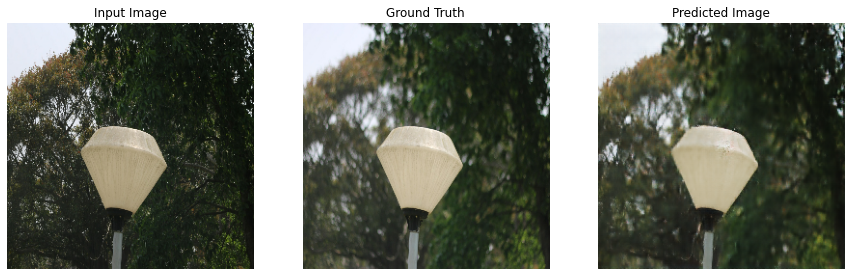

Step: 39k
....................................................................................................

In [ ]:
fit(train_dataset, steps=40000)

#Bokeh Image generation

In [ ]:
from skimage.transform import resize
import os
from io import BytesIO
import tarfile
import tempfile
import cv2
from six.moves import urllib
from copy import deepcopy
from matplotlib import gridspec
from matplotlib import pyplot as plt
import numpy as np
from PIL import Image
from IPython.display import Image as IMG

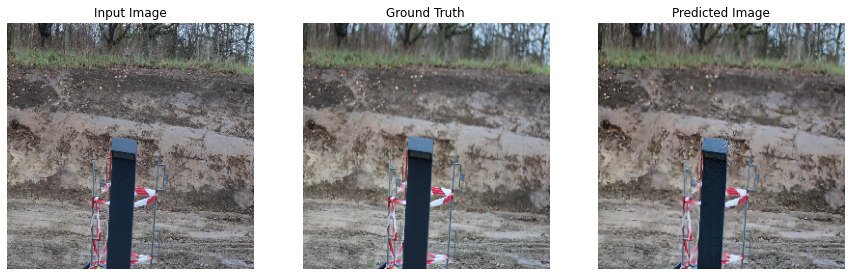

In [ ]:
example_input, example_target = next(iter(train_dataset.take(1)))
generate_images(generator, example_input, example_target)

In [ ]:
bokeh_GT = "/content/bokeh/"
bokeh_Original = "/content/original/"
outputdir = "/content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/"

In [ ]:
def generate_images_and_save(model, test_input):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(15, 15))

  # Getting the pixel values in the [0, 1] range to plot.
  plt.imshow(prediction[0] * 0.5 + 0.5)
  plt.axis('off')
  plt.savefig("temp.jpg")
  plt.show()

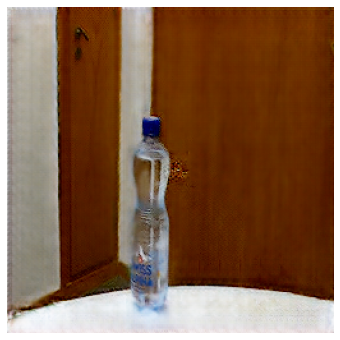

processing: 1 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/0.jpg


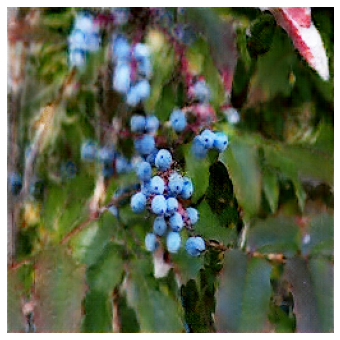

processing: 2 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/1.jpg


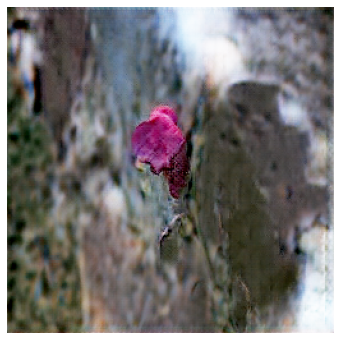

processing: 3 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/2.jpg


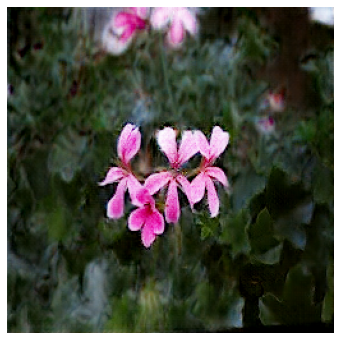

processing: 4 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/3.jpg


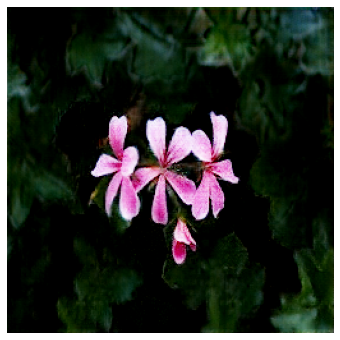

processing: 5 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/4.jpg


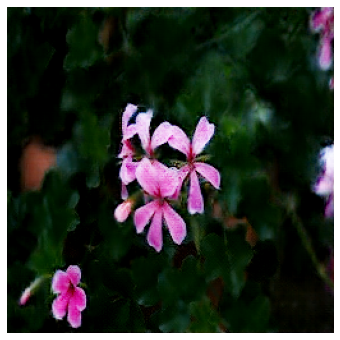

processing: 6 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/5.jpg


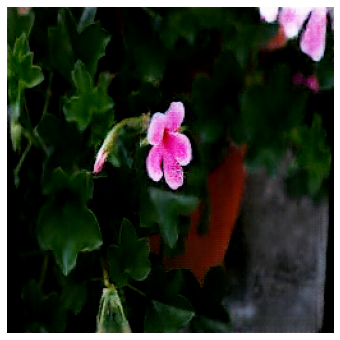

processing: 7 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/6.jpg


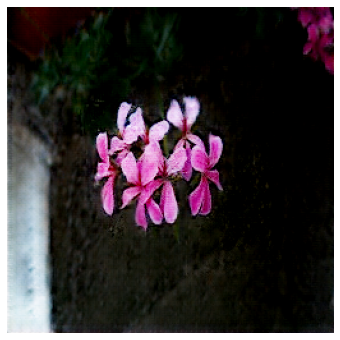

processing: 8 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/7.jpg


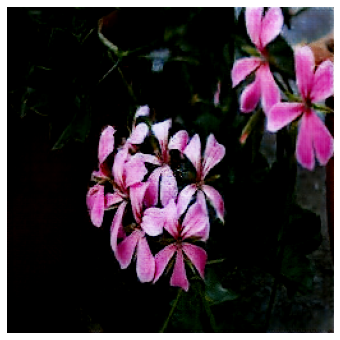

processing: 9 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/8.jpg


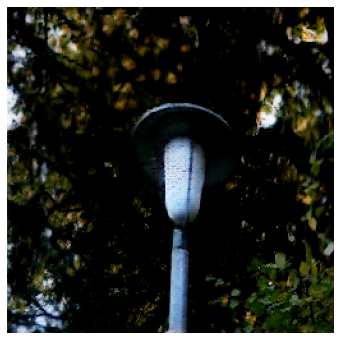

processing: 10 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/9.jpg


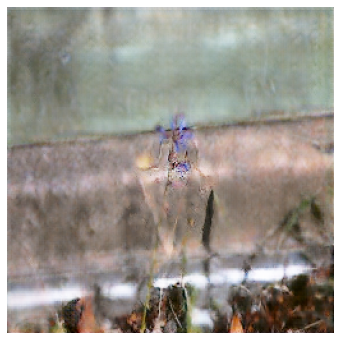

processing: 11 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/10.jpg


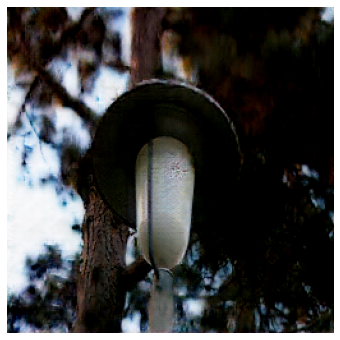

processing: 12 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/11.jpg


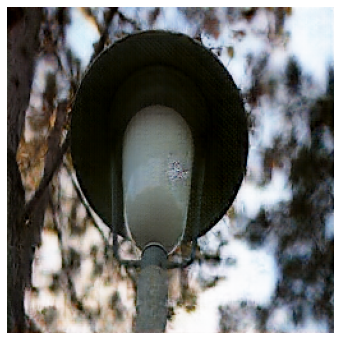

processing: 13 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/12.jpg


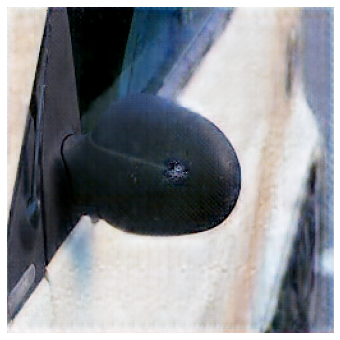

processing: 14 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/13.jpg


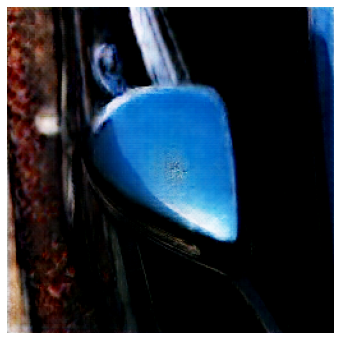

processing: 15 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/14.jpg


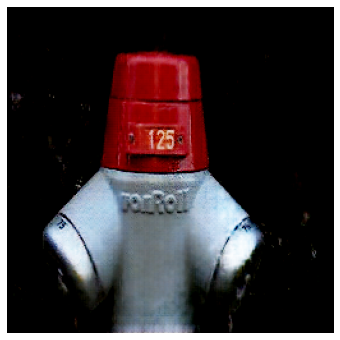

processing: 16 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/15.jpg


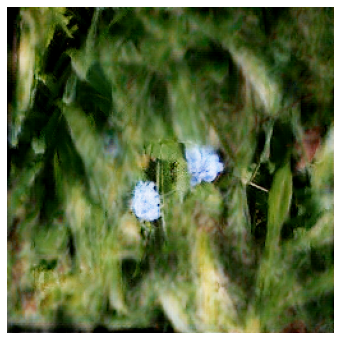

processing: 17 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/16.jpg


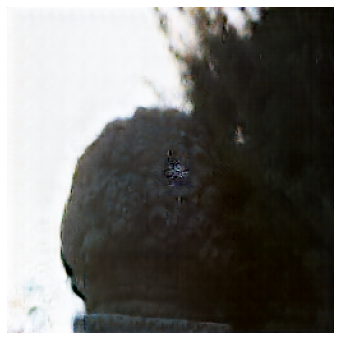

processing: 18 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/17.jpg


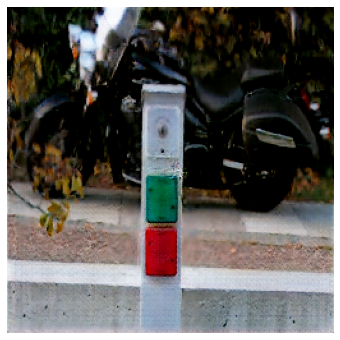

processing: 19 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/18.jpg


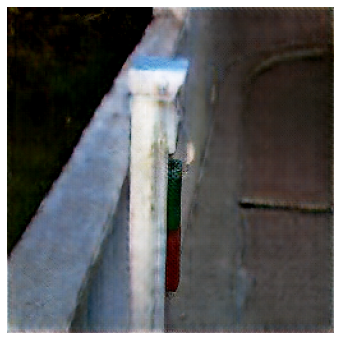

processing: 20 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/19.jpg


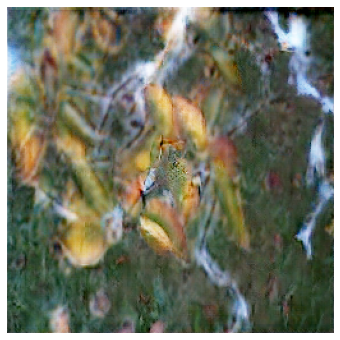

processing: 21 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/20.jpg


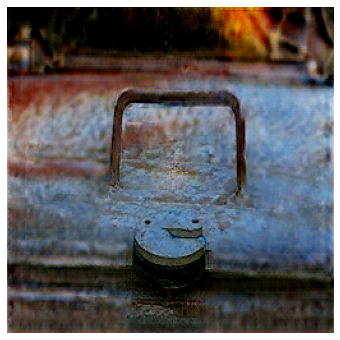

processing: 22 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/21.jpg


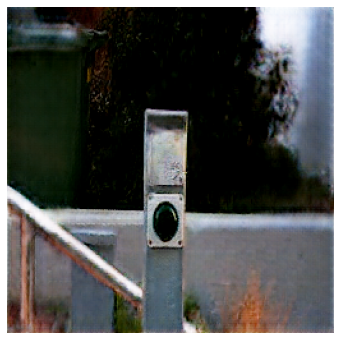

processing: 23 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/22.jpg


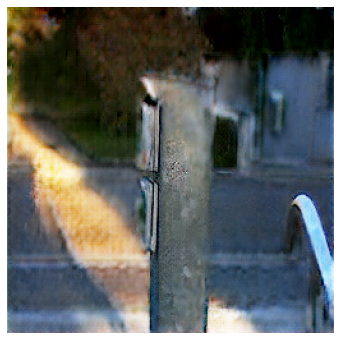

processing: 24 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/23.jpg


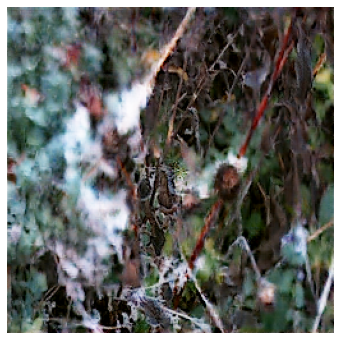

processing: 25 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/24.jpg


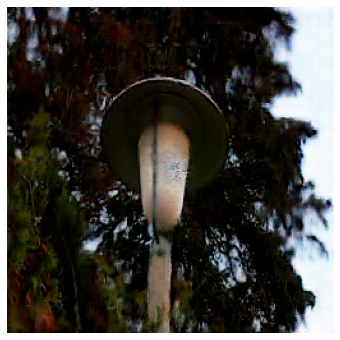

processing: 26 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/25.jpg


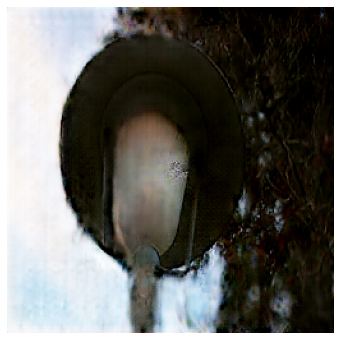

processing: 27 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/26.jpg


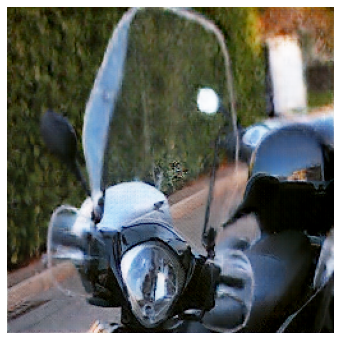

processing: 28 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/27.jpg


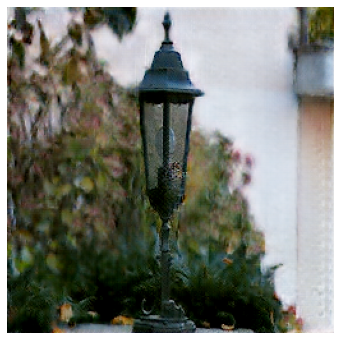

processing: 29 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/28.jpg


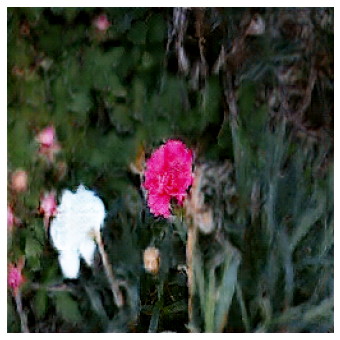

processing: 30 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/29.jpg


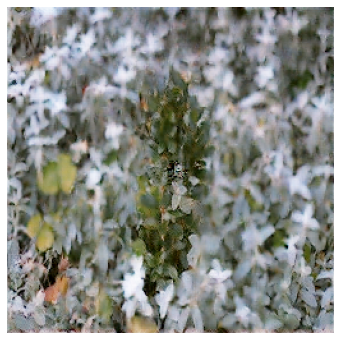

processing: 31 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/30.jpg


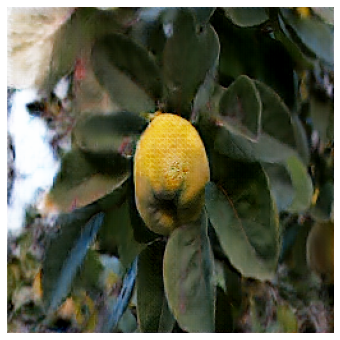

processing: 32 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/31.jpg


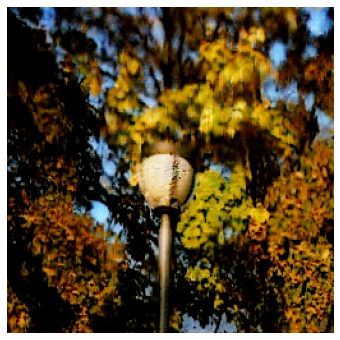

processing: 33 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/32.jpg


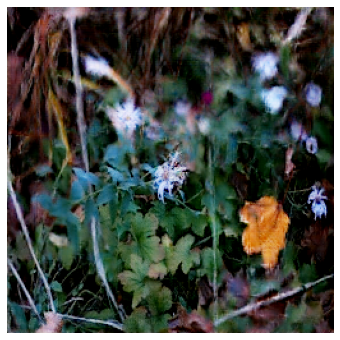

processing: 34 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/33.jpg


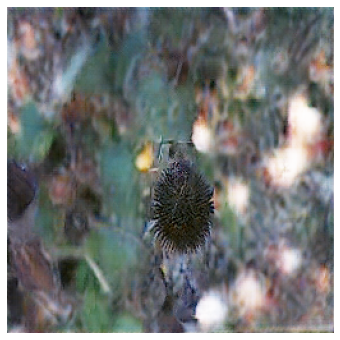

processing: 35 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/34.jpg


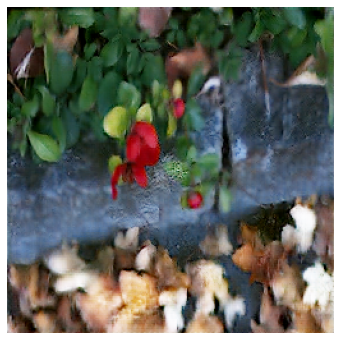

processing: 36 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/35.jpg


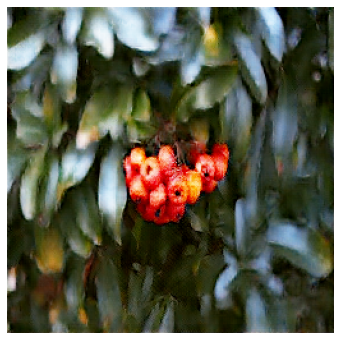

processing: 37 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/36.jpg


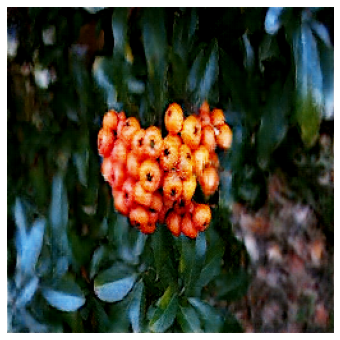

processing: 38 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/37.jpg


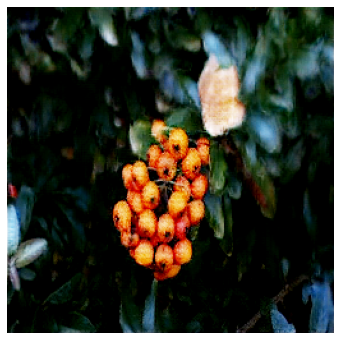

processing: 39 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/38.jpg


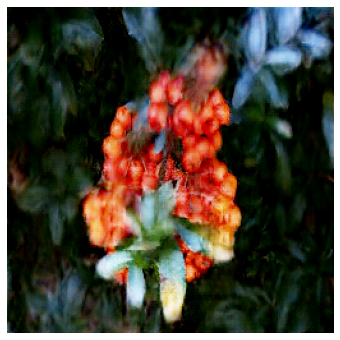

processing: 40 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/39.jpg


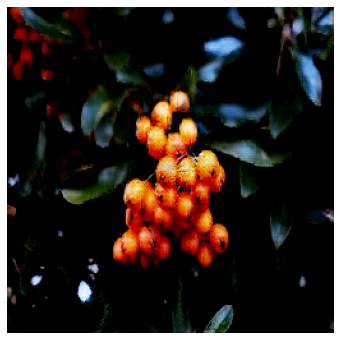

processing: 41 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/40.jpg


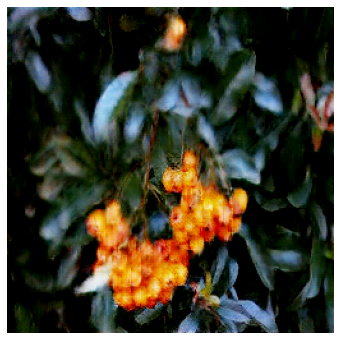

processing: 42 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/41.jpg


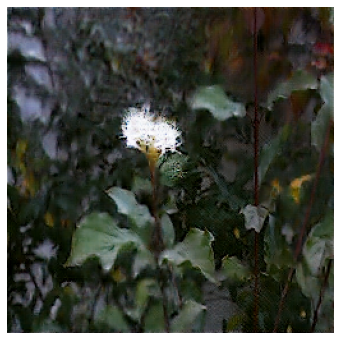

processing: 43 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/42.jpg


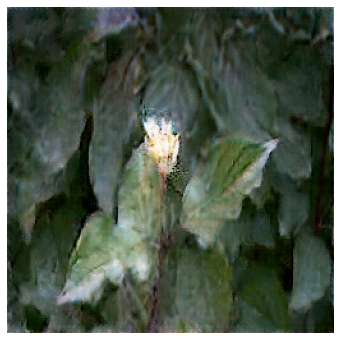

processing: 44 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/43.jpg


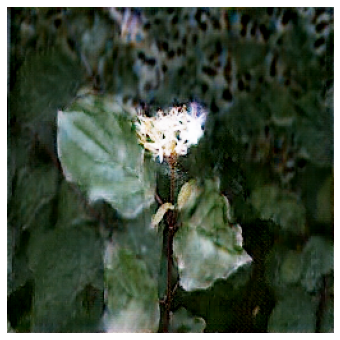

processing: 45 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/44.jpg


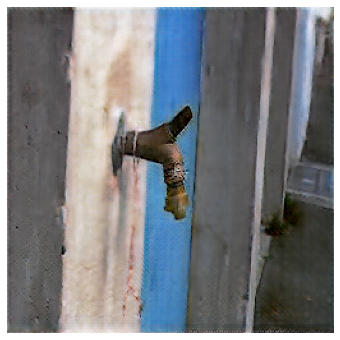

processing: 46 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/45.jpg


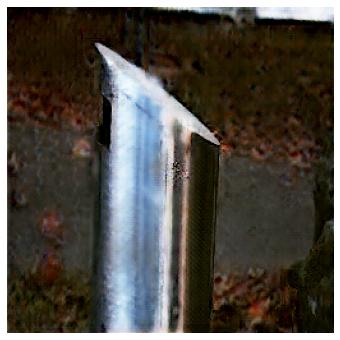

processing: 47 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/46.jpg


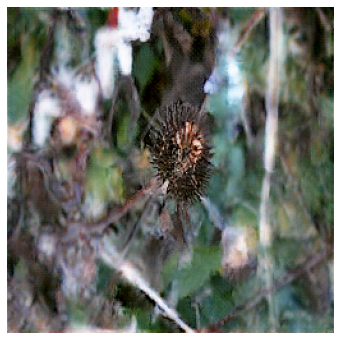

processing: 48 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/47.jpg


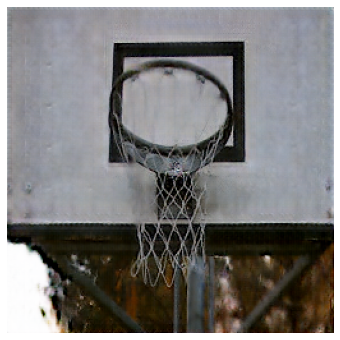

processing: 49 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/48.jpg


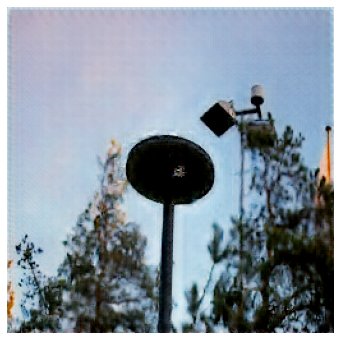

processing: 50 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/49.jpg


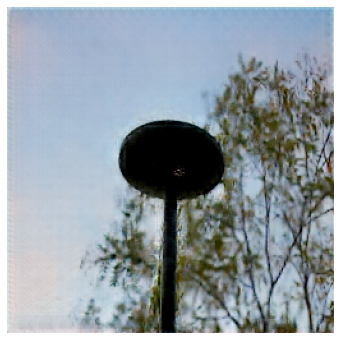

processing: 51 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/50.jpg


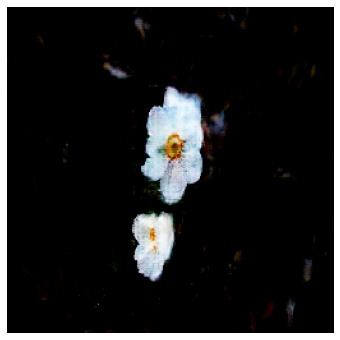

processing: 52 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/51.jpg


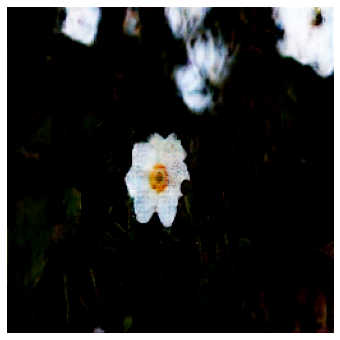

processing: 53 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/52.jpg


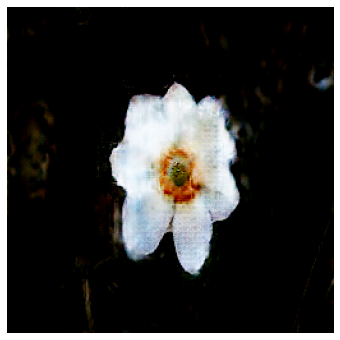

processing: 54 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/53.jpg


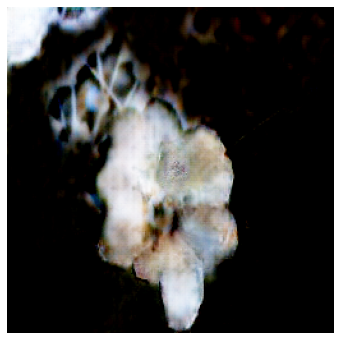

processing: 55 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/54.jpg


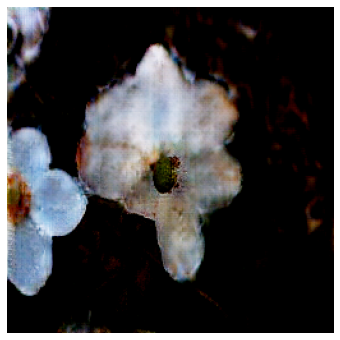

processing: 56 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/55.jpg


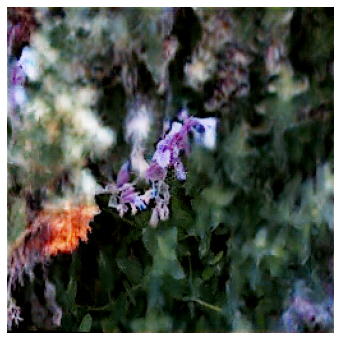

processing: 57 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/56.jpg


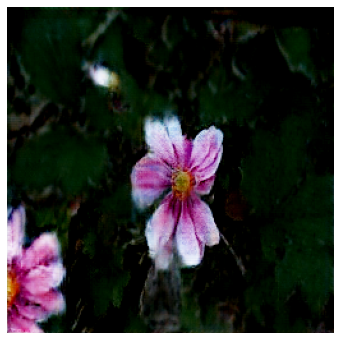

processing: 58 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/57.jpg


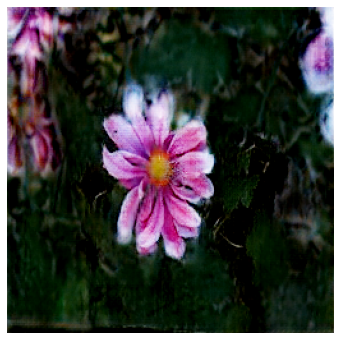

processing: 59 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/58.jpg


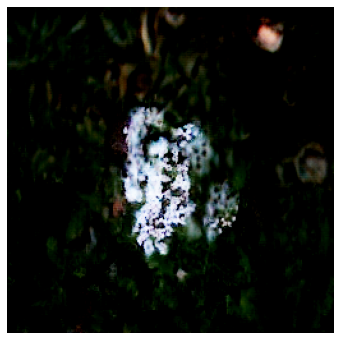

processing: 60 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/59.jpg


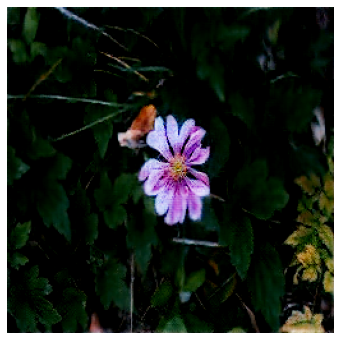

processing: 61 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/60.jpg


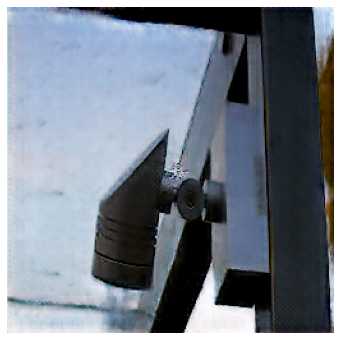

processing: 62 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/61.jpg


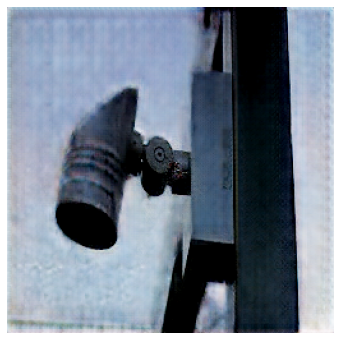

processing: 63 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/62.jpg


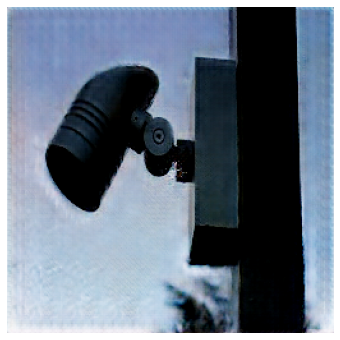

processing: 64 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/63.jpg


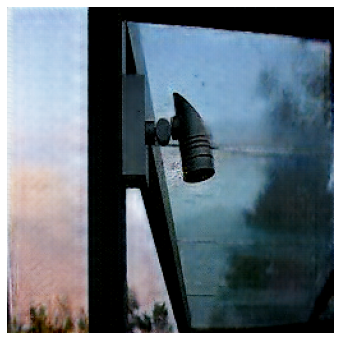

processing: 65 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/64.jpg


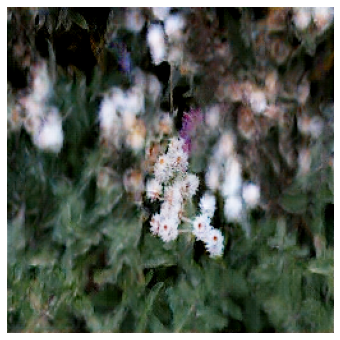

processing: 66 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/65.jpg


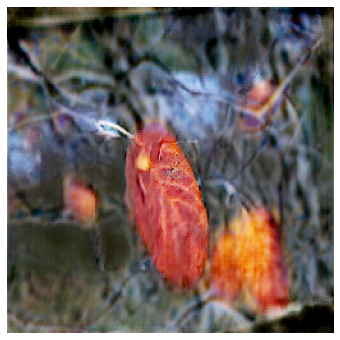

processing: 67 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/66.jpg


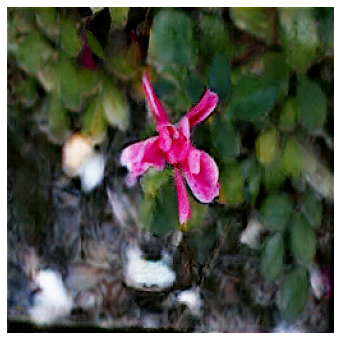

processing: 68 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/67.jpg


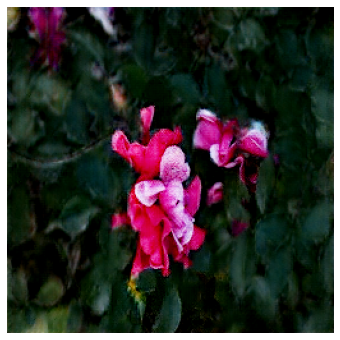

processing: 69 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/68.jpg


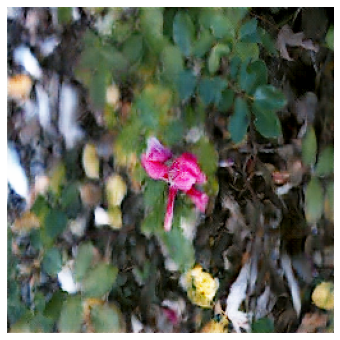

processing: 70 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/69.jpg


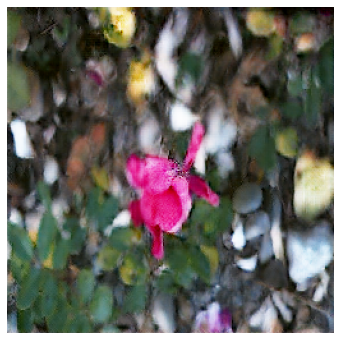

processing: 71 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/70.jpg


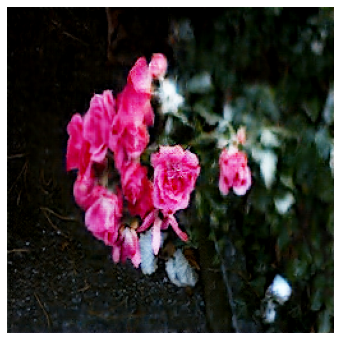

processing: 72 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/71.jpg


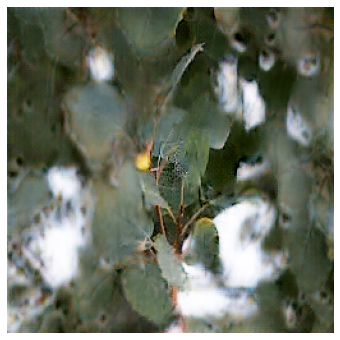

processing: 73 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/72.jpg


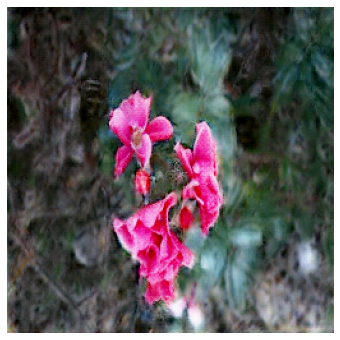

processing: 74 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/73.jpg


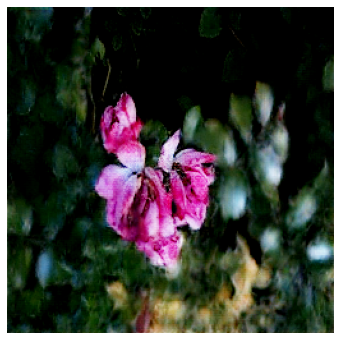

processing: 75 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/74.jpg


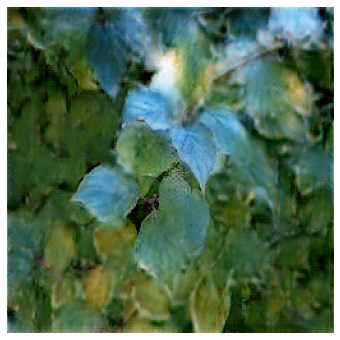

processing: 76 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/75.jpg


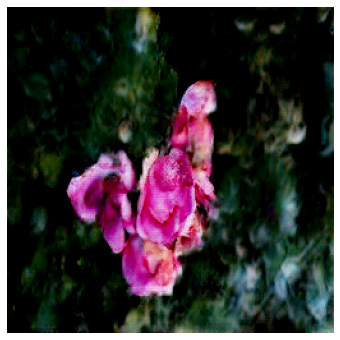

processing: 77 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/76.jpg


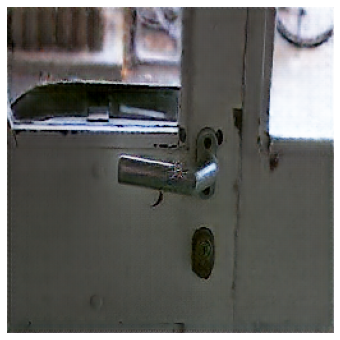

processing: 78 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/77.jpg


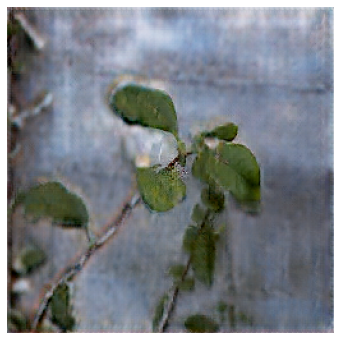

processing: 79 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/78.jpg


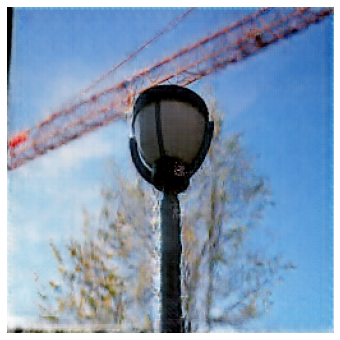

processing: 80 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/79.jpg


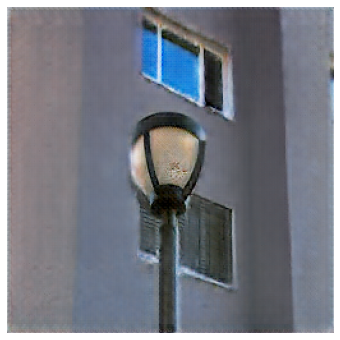

processing: 81 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/80.jpg


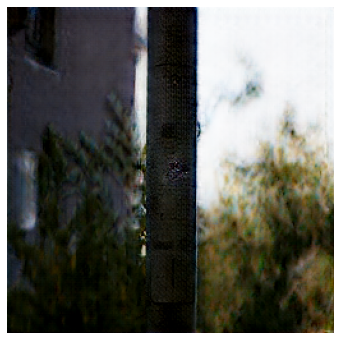

processing: 82 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/81.jpg


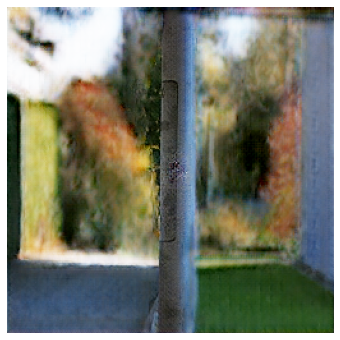

processing: 83 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/82.jpg


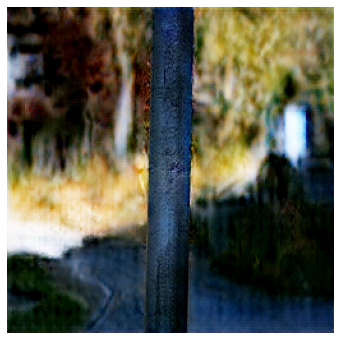

processing: 84 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/83.jpg


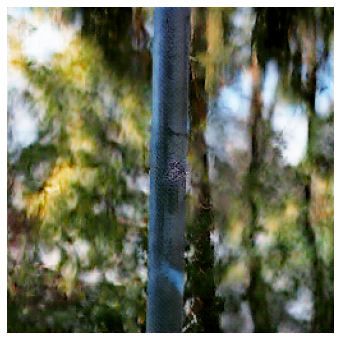

processing: 85 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/84.jpg


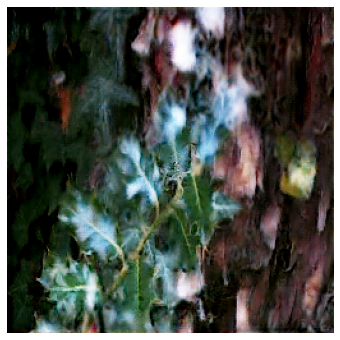

processing: 86 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/85.jpg


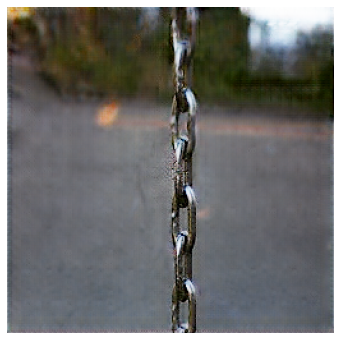

processing: 87 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/86.jpg


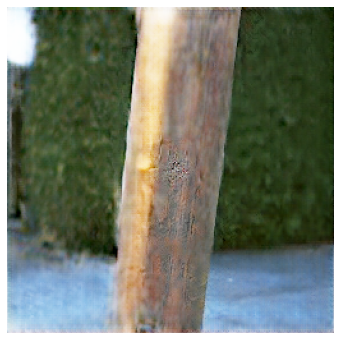

processing: 88 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/87.jpg


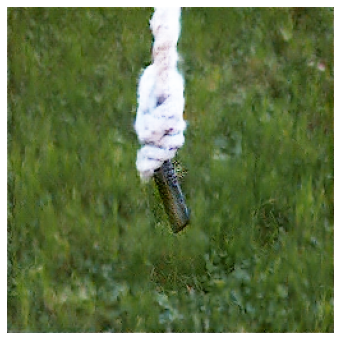

processing: 89 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/88.jpg


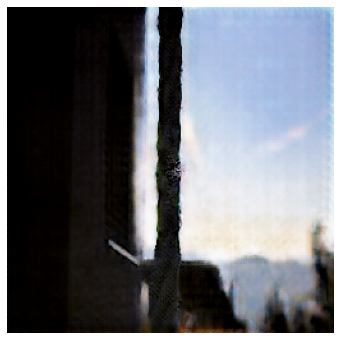

processing: 90 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/89.jpg


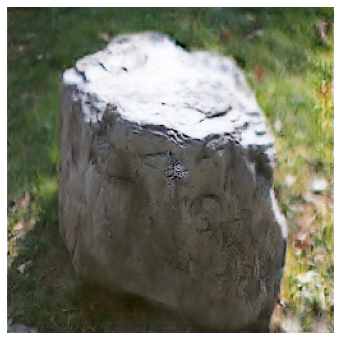

processing: 91 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/90.jpg


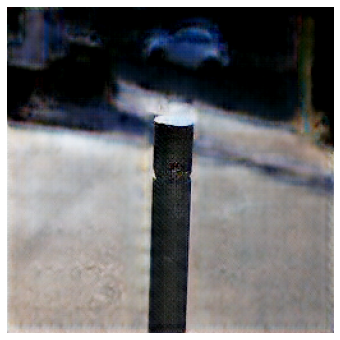

processing: 92 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/91.jpg


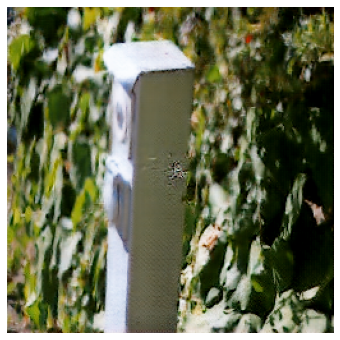

processing: 93 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/92.jpg


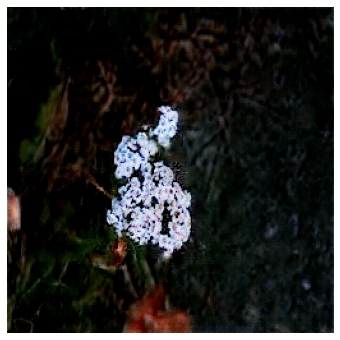

processing: 94 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/93.jpg


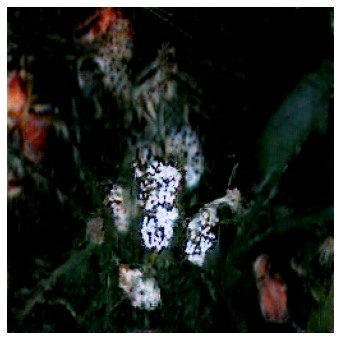

processing: 95 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/94.jpg


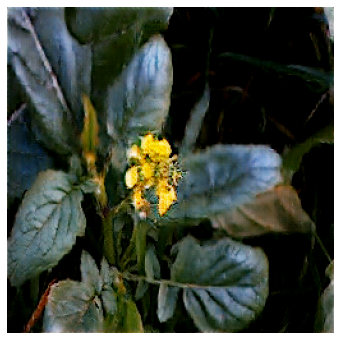

processing: 96 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/95.jpg


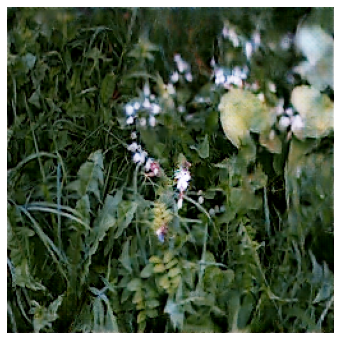

processing: 97 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/96.jpg


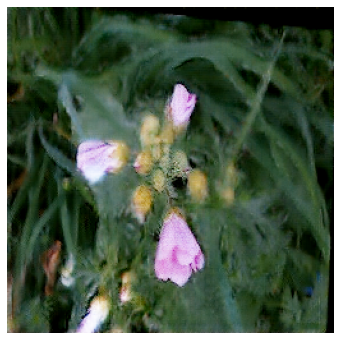

processing: 98 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/97.jpg


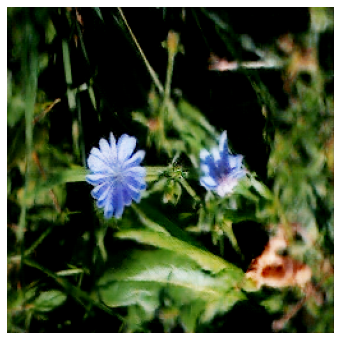

processing: 99 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/98.jpg


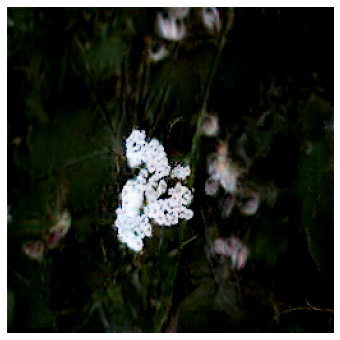

processing: 100 /100, save img: /content/drive/Shareddrives/DeepLearning_VisionAnalytics/Pix2Pix_Model/Output_on_our_set_3/99.jpg
processed


In [ ]:
if not os.path.exists(outputdir):
    os.mkdir(outputdir)

for i in range(100):
    img = bokeh_Original + str(i) + ".jpg"
    out_name = os.path.basename(img)
    orginal_img = np.array(Image.open(img))
    orginal_img_resized = np.expand_dims(resize(orginal_img, (256, 256, 3)), 0)

    #generate_images_and_save(generator, orginal_img_resized)
    gen_output = generator(orginal_img_resized, training=True)
    gen_output = gen_output[0]# * 0.5 + 0.5
    
    plt.figure(figsize=(6,6))
    display_list = [orginal_img_resized[0], gen_output]
    title = ['Input Image', 'Predicted Image']

    plt.imshow(gen_output)# * 0.5 + 0.5)
    plt.axis('off')
    plt.savefig(os.path.join(outputdir, out_name), bbox_inches='tight', pad_inches = 0)
    plt.show()
    print('processing:',i+1, '/100, save img:',os.path.join(outputdir, out_name))
print('processed')

# Evaluation

##PSNR

In [ ]:
from math import log10, sqrt
import cv2
import numpy as np
from skimage.transform import resize
  
def PSNR(original, compressed):
    mse = np.mean((original - compressed) ** 2)
    if(mse == 0):  # MSE is zero means no noise is present in the signal .
                  # Therefore PSNR have no importance.
        return 100
    max_pixel = 255.0
    psnr = 20 * log10(max_pixel / sqrt(mse))
    return psnr

In [ ]:
values = []
for i in range(100):
  img1 = bokeh_GT + str(i) + ".jpg"
  img2 = outputdir + str(i) + ".jpg"

  generated_bokeh = cv2.imread(img2)
  ground_truth_bokeh = resize(cv2.imread(img1), (generated_bokeh.shape[0], generated_bokeh.shape[1], 3))
  ground_truth_bokeh *= (255.0/ground_truth_bokeh.max())
  values.append(PSNR(ground_truth_bokeh, generated_bokeh))
values = np.array(values)
print(f"Avg PSNR value is {np.average(values)} dB")

Avg PSNR value is 16.743790658791564 dB


## SSIM

In [ ]:
import math
import numpy as np
import cv2

def ssim(img1, img2):
    C1 = (0.01 * 255)**2
    C2 = (0.03 * 255)**2

    img1 = img1.astype(np.float64)
    img2 = img2.astype(np.float64)
    kernel = cv2.getGaussianKernel(11, 1.5)
    window = np.outer(kernel, kernel.transpose())

    mu1 = cv2.filter2D(img1, -1, window)[5:-5, 5:-5]  # valid
    mu2 = cv2.filter2D(img2, -1, window)[5:-5, 5:-5]
    mu1_sq = mu1**2
    mu2_sq = mu2**2
    mu1_mu2 = mu1 * mu2
    sigma1_sq = cv2.filter2D(img1**2, -1, window)[5:-5, 5:-5] - mu1_sq
    sigma2_sq = cv2.filter2D(img2**2, -1, window)[5:-5, 5:-5] - mu2_sq
    sigma12 = cv2.filter2D(img1 * img2, -1, window)[5:-5, 5:-5] - mu1_mu2

    ssim_map = ((2 * mu1_mu2 + C1) * (2 * sigma12 + C2)) / ((mu1_sq + mu2_sq + C1) *
                                                            (sigma1_sq + sigma2_sq + C2))
    return ssim_map.mean()


def calculate_ssim(img1, img2):
    '''calculate SSIM
    the same outputs as MATLAB's
    img1, img2: [0, 255]
    '''
    if not img1.shape == img2.shape:
        raise ValueError('Input images must have the same dimensions.')
    if img1.ndim == 2:
        return ssim(img1, img2)
    elif img1.ndim == 3:
        if img1.shape[2] == 3:
            ssims = []
            for i in range(3):
                ssims.append(ssim(img1, img2))
            return np.array(ssims).mean()
        elif img1.shape[2] == 1:
            return ssim(np.squeeze(img1), np.squeeze(img2))
    else:
        raise ValueError('Wrong input image dimensions.')

In [ ]:
values = []
for i in range(100):
  img1 = bokeh_GT + str(i) + ".jpg"
  img2 = outputdir + str(i) + ".jpg"

  generated_bokeh = cv2.imread(img2)
  ground_truth_bokeh = resize(cv2.imread(img1), (generated_bokeh.shape[0], generated_bokeh.shape[1], 3))
  ground_truth_bokeh *= (255.0/ground_truth_bokeh.max())
  
  values.append(calculate_ssim(ground_truth_bokeh, generated_bokeh))
values = np.array(values)
print(f"Avg SSIM value is {np.average(values)} dB")

Avg SSIM value is 0.4412594691790906 dB
